<a href="https://colab.research.google.com/github/charigardash/Helmet_Segmentation_YOLOv8/blob/main/Helmet_Segmentation_YOLOv8.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#**Importing the Required Libraries**

In [1]:
#Importing  os to create a helper variable, which allows us to easily manages different paths in the code
import os

In [2]:
#glob is used to return all file paths that match a specific pattern.
import glob

In [3]:
# If we want to display a single image, then "Image" Library is fine, but if we want to display multiple images by just running a single cell
# then we need to import display

from IPython.display import Image, display

# **In the First Step, We need to check whether we have access to the GPU or not**

In [4]:
!nvidia-smi

Sat Aug 17 17:54:58 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla T4                       Off | 00000000:00:04.0 Off |                    0 |
| N/A   43C    P8              10W /  70W |      0MiB / 15360MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

In [5]:
HOME = os.getcwd()

In [6]:
print(HOME)

/content


In [7]:
!git clone https://github.com/MuhammadMoin97/ultralytics.git

Cloning into 'ultralytics'...
remote: Enumerating objects: 3878, done.
remote: Total 3878 (delta 0), reused 0 (delta 0), pack-reused 3878 (from 1)
Receiving objects: 100% (3878/3878), 1.82 MiB | 4.75 MiB/s, done.
Resolving deltas: 100% (2693/2693), done.


#**Setting the Current Directory**

In [7]:
%cd {HOME}/ultralytics

/content/ultralytics


#**Installing all the Dependencies**

In [8]:
!pip install -e '.[dev]'

Obtaining file:///content/ultralytics
  Preparing metadata (setup.py) ... done
  Attempting uninstall: ultralytics
    Found existing installation: ultralytics 8.0.3
    Uninstalling ultralytics-8.0.3:
      Successfully uninstalled ultralytics-8.0.3
  Running setup.py develop for ultralytics


In [9]:
import ultralytics

In [10]:
ultralytics.checks()

Ultralytics YOLOv8.0.3 🚀 Python-3.10.12 torch-2.3.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Setup complete ✅ (2 CPUs, 12.7 GB RAM, 33.7/78.2 GB disk)


#**Importing the Helmets Segmentation Dataset from Roboflow**

In [11]:
HOME = '/content/ultralytics/ultralytics/yolo/v8/segment'

In [12]:
%cd  '/content/ultralytics/ultralytics/yolo/v8/segment'

/content/ultralytics/ultralytics/yolo/v8/segment


In [13]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="iOqPD5zonb3Ou6XZ2Xpe")
project = rf.workspace("celebal").project("helmet-mvi3d")
dataset = project.version(2).download("yolov7")

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.1/79.1 kB 4.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.5/54.5 kB 4.6 MB/s eta 0:00:00
loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to Helmet-2 in yolov7pytorch:: 100%|██████████| 601/601 [00:00<00:00, 4552.41it/s]


#**Train the YOLOv8 Model on the Custom Dataset**

In [24]:
%cd {HOME}

/content/ultralytics/ultralytics/yolo/v8/segment


In [25]:
dataset.location  = '/content/ultralytics/ultralytics/yolo/v8/segment/Helmet'

In [26]:
%cd {dataset.location}

/content/ultralytics/ultralytics/yolo/v8/segment/Helmet


In [27]:
%cd {HOME}

!python train.py model=yolov8l-seg.pt data={dataset.location}/data.yaml epochs=80 imgsz=640

/content/ultralytics/ultralytics/yolo/v8/segment
yolo/engine/trainer: task=segment, mode=train, model=yolov8l-seg.pt, data=/content/ultralytics/ultralytics/yolo/v8/segment/Helmet/data.yaml, epochs=80, patience=50, batch=16, imgsz=640, save=True, cache=False, device=None, workers=8, project=None, name=None, exist_ok=False, pretrained=False, optimizer=SGD, verbose=False, seed=0, deterministic=True, single_cls=False, image_weights=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf=False, save_crop=False, hide_labels=False, hide_conf=False, vid_stride=1, line_thickness=3, visualize=False, augment=False, agnostic_nms=False, retina_masks=False, format=torchscript, keras=False, optimize=False, int8=False, dynamic=False, simplify=False, opset=17, workspace=4, nms=False, lr0

In [28]:
!ls {HOME}/runs/segment/train4

args.yaml					    MaskP_curve.png	 train_batch1191.jpg
BoxF1_curve.png					    MaskPR_curve.png	 train_batch1192.jpg
BoxP_curve.png					    MaskR_curve.png	 train_batch1.jpg
BoxPR_curve.png					    predictions.json	 train_batch2.jpg
BoxR_curve.png					    results.csv		 val_batch0_labels.jpg
confusion_matrix.png				    results.png		 val_batch0_pred.jpg
events.out.tfevents.1723918255.e7f378d129ed.7032.0  train_batch0.jpg	 weights
MaskF1_curve.png				    train_batch1190.jpg


#**Displaying the Confusion Matrix**

/content/ultralytics/ultralytics/yolo/v8/segment


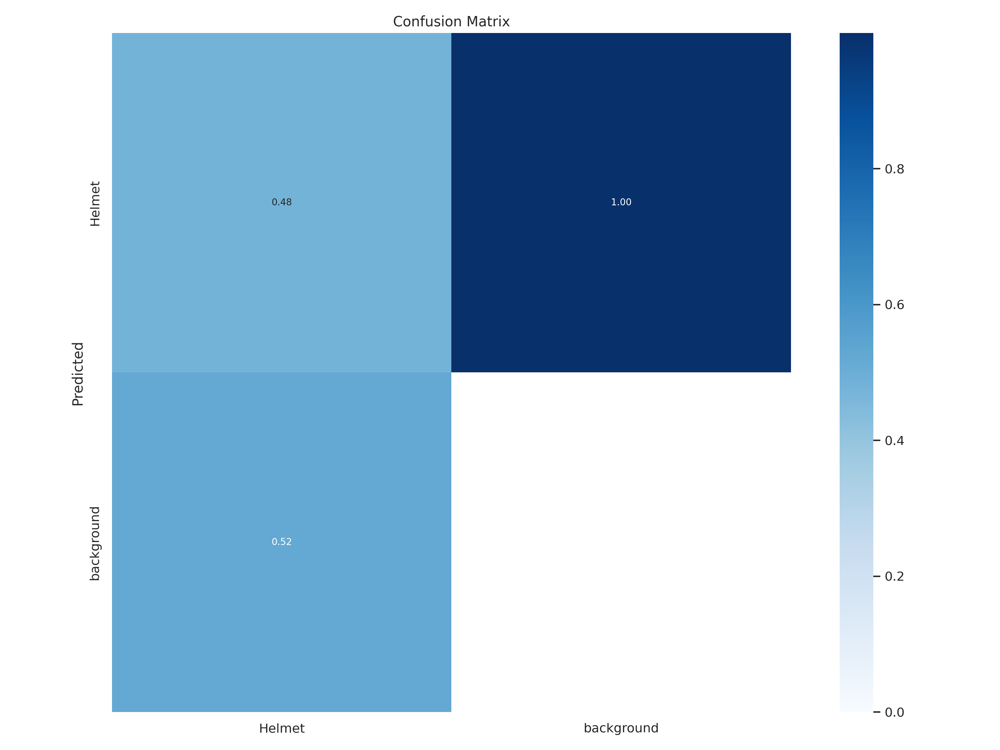

In [29]:
#Confusion matrix is the chart that shows how our model handles different classes
#92% of the time the model detected correctly that the person is wearing the helmet,  while 1% of the time when the person is wearing the helmet
#the model is unable to detect it
%cd {HOME}
Image(filename=f'{HOME}/runs/segment/train4/confusion_matrix.png', width=900)

#**Training and Validation Loss**

/content/ultralytics/ultralytics/yolo/v8/segment


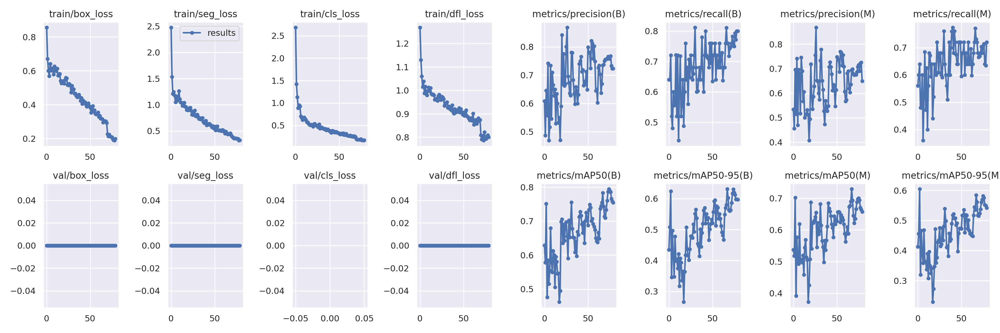

In [30]:
# Here is the graph of the training and validation loss
#box loss and class loss is important
# The behavior of the model is convincing the model is coverging, Training more will give better results
%cd {HOME}

Image(filename=f'{HOME}/runs/segment/train4/results.png', width=600)

/content/ultralytics/ultralytics/yolo/v8/segment


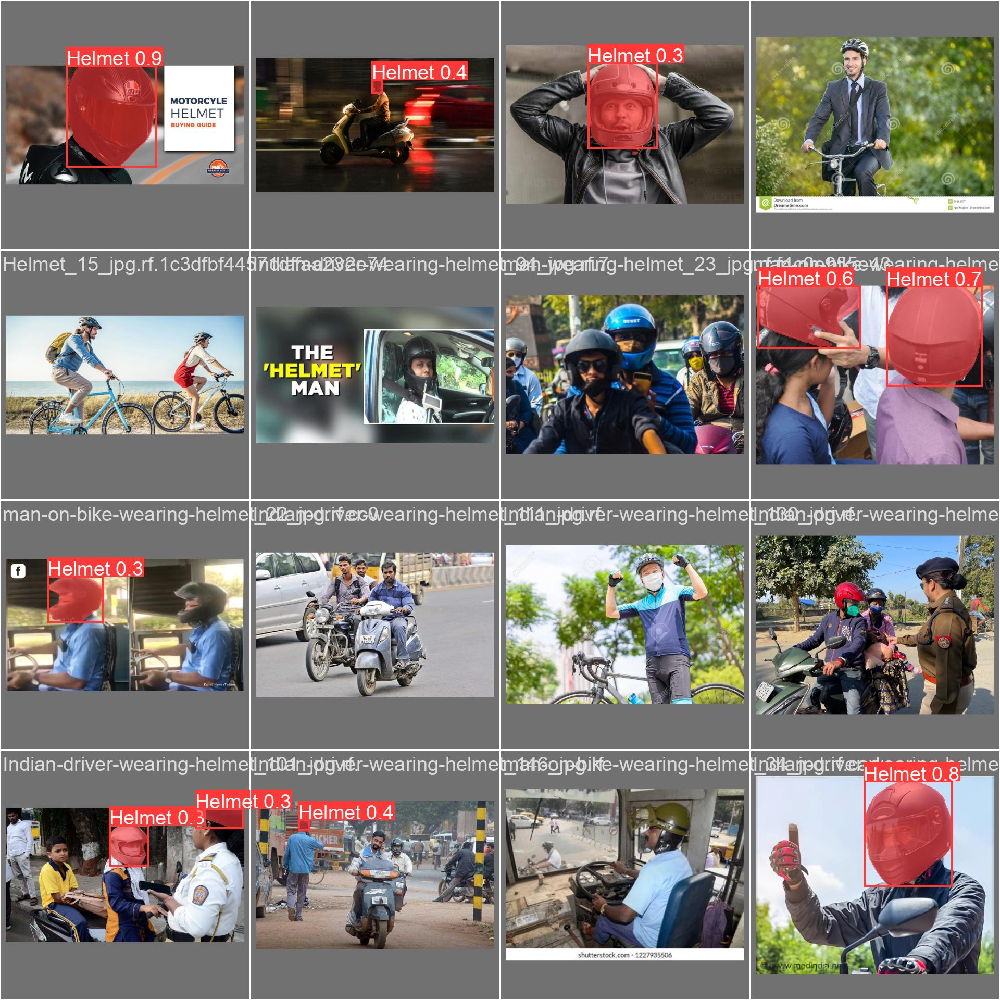

In [31]:
#Model Prediction on validation batch. These image are not used strictly for training so it is always better to take a
#look and see how model is behaving
%cd {HOME}
Image(filename=f'{HOME}/runs/segment/train4/val_batch0_pred.jpg', width=600)

#**Validate Custom Model**

In [32]:
#Here, we are taking the model best weights and using them to validate the model

%cd {HOME}

!python val.py model='{HOME}/runs/segment/train4/weights/best.pt' data={dataset.location}/data.yaml

/content/ultralytics/ultralytics/yolo/v8/segment
2024-08-17 18:54:52.289317: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-08-17 18:54:52.309239: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-08-17 18:54:52.315381: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-08-17 18:54:52.330240: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F FMA, in other operations, rebuild TensorFlow with the appropriate compiler fla

#**Testing on a Demo Video**

In [33]:
!gdown "https://drive.google.com/uc?id=11frm2lKu_Rd4XNZ3dyynCSjMymN66_I8&confirm=t"

Downloading...
From: https://drive.google.com/uc?id=11frm2lKu_Rd4XNZ3dyynCSjMymN66_I8&confirm=t
To: /content/ultralytics/ultralytics/yolo/v8/segment/demo1.mp4
100% 10.1M/10.1M [00:00<00:00, 43.3MB/s]


In [34]:
!pwd

/content/ultralytics/ultralytics/yolo/v8/segment


In [35]:
%cd {HOME}

!python predict.py model='{HOME}/runs/segment/train4/weights/best.pt' source='demo1.mp4'

/content/ultralytics/ultralytics/yolo/v8/segment
2024-08-17 18:56:18.707138: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-08-17 18:56:18.739715: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-08-17 18:56:18.749840: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-08-17 18:56:18.772160: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F FMA, in other operations, rebuild TensorFlow with the appropriate compiler fla

#**Display the Demo Video**

In [38]:
!rm "/content/result_compressed.mp4"

In [37]:
from IPython.display import HTML
from base64 import b64encode
import os

# Input video path
save_path = '/content/ultralytics/ultralytics/yolo/v8/segment/runs/detect/train2/demo1.mp4'

# Compressed video path
compressed_path = "/content/result_compressed.mp4"

os.system(f"ffmpeg -i {save_path} -vcodec libx264 {compressed_path}")

# Show video
mp4 = open(compressed_path,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

#**Downloading the Demo Video2**

In [ ]:
!gdown "https://drive.google.com/uc?id=1Q2tEqmTACa84EXGIiJitrCkoI_VlzjMH&confirm=t"

#**Testing on the Demo Video**

In [44]:
%cd {HOME}

!python predict.py model='{HOME}/runs/segment/train4/weights/best.pt' source='newbike.mp4'

/content/ultralytics/ultralytics/yolo/v8/segment
2024-08-17 19:04:34.800357: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-08-17 19:04:34.820418: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-08-17 19:04:34.826639: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-08-17 19:04:34.841900: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F FMA, in other operations, rebuild TensorFlow with the appropriate compiler fla

#**Display the Demo Video**

In [42]:
!rm "/content/result_compressed.mp4"

rm: cannot remove '/content/result_compressed.mp4': No such file or directory


In [43]:
from IPython.display import HTML
from base64 import b64encode
import os

# Input video path
save_path = '/content/ultralytics/ultralytics/yolo/v8/segment/runs/detect/train2/newbike.mp4'

# Compressed video path
compressed_path = "/content/result_compressed.mp4"

os.system(f"ffmpeg -i {save_path} -vcodec libx264 {compressed_path}")

# Show video
mp4 = open(compressed_path,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

FileNotFoundError: [Errno 2] No such file or directory: '/content/result_compressed.mp4'